# Life as Turing Complete

This notebook demonstrates implementation for Module 1 of my Modelling complex system's course.
I embarked on implementing a from scratch pipeline that tries to prove Conways Game of Life (CGoL) as Turing Complete

Name: Darsh SA

Reg. No: MS22068


## Turing Completeness in Game of Life

A system is **Turing complete** if it can simulate any Turing machine given enough space/time.

Thus we formalise the requirements to prove CGoL as Turing complete as:

1. Life supports signal transmission.
2. Life supports universal Boolean logic.
3. Life supports memory (feedback, latch).

Conway's Game of Life is known to be Turing complete in theory. This notebook shows how this implementation builds those ingredients concretely.


In [1]:
from pathlib import Path
import sys

start = Path.cwd().resolve()
ROOT = start
for candidate in [start, *start.parents]:
    if (candidate / "src" / "demo.py").exists():
        ROOT = candidate
        break

SRC = ROOT / "src"
if str(SRC) not in sys.path:
    sys.path.append(str(SRC))

import demo

ctx = demo.create_context(ROOT)
demo.print_context(ctx)


Project root: /home/ardo/mlem/Study/Sem8/MCS/M1
Output dir:   /home/ardo/mlem/Study/Sem8/MCS/M1/tests/output/notebook


---

## 1. Basic Rules of Conway's Game of Life

Conway's Life uses `B3/S23`:
- Birth: dead cell with exactly 3 neighbors becomes alive.
- Survival: live cell survives with 2 or 3 neighbors.

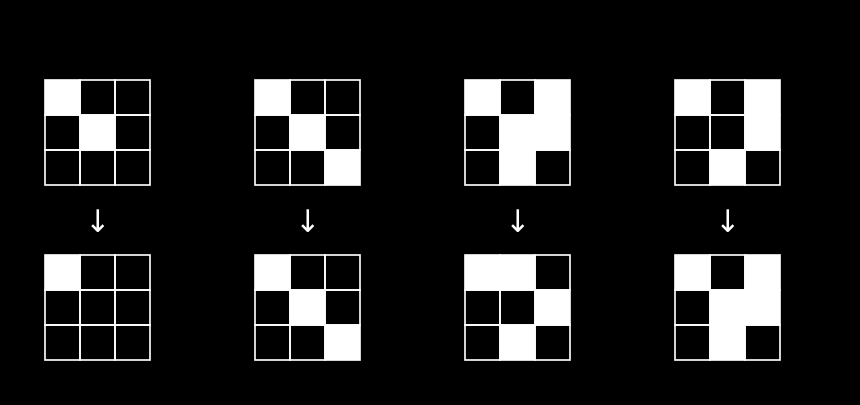

Thus using the above ruleset CGoL gives birth to various different patterns
ref: https://en.wikipedia.org/wiki/Conway%27s_Game_of_Life#Pattern_taxonomy

one of the most common pattern "The Glider" is generated below

Snapshot: /home/ardo/mlem/Study/Sem8/MCS/M1/tests/output/notebook/glider_t0_1771471961169.png (8956 bytes)


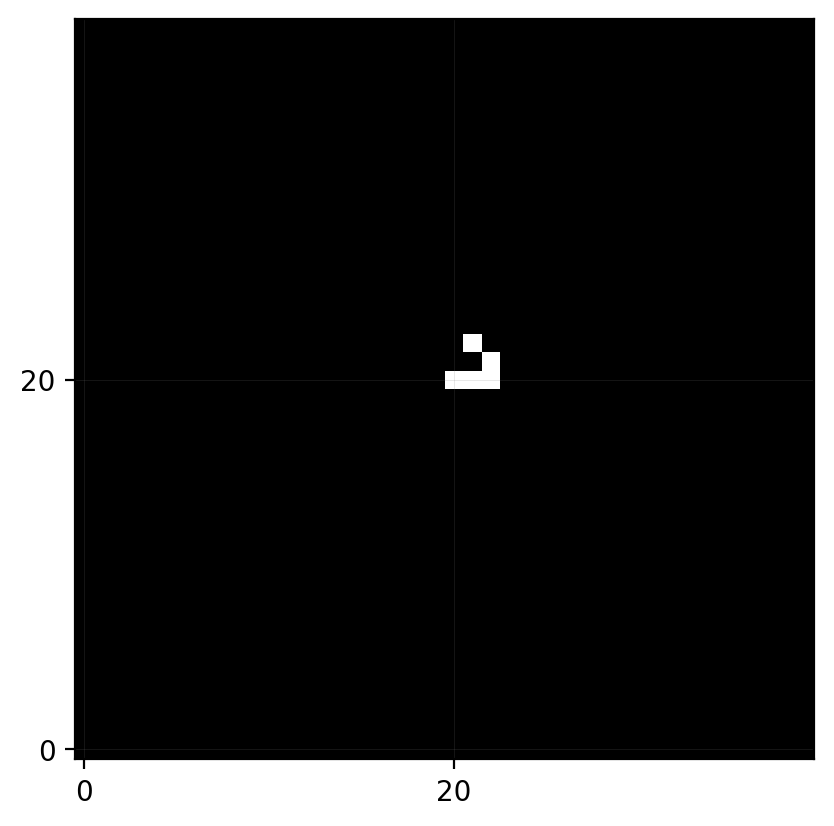

Animation: /home/ardo/mlem/Study/Sem8/MCS/M1/tests/output/notebook/glider_motion_1771471961286.mp4 (22137 bytes)


In [2]:
demo.run_basic_rules_demo(ctx)


## 2. Components and Patterns in This Project

To prove CGoL is Turing Complete we will use some of the following patterns as building blocks of our system:
- `glider`
- `gun`
- `eater`
- `reflector`

From these patterns (or hereby called atomic componenents) we can build all the componenets required by our system to prove its turing complete


In [2]:
demo.run_atomic_component_grid(ctx)


---


## 3. Proving Turing Completeness

Now that we have our building blocks setup we have start wit ticking off what makes CGoL Turing complete and implement each requirement


### A. Signal Transmition

We implement signal ticks by using the `Glider` and then a stream of gliders represent a signal. As we saw earlier a stream of gliders can be created with something called Glider guns, here we have used a [Gospers Glider Gun](https://conwaylife.com/wiki/Gosper_glider_gun)

Now for propogation, we want our signal to redirect in any direction we want. For this we use the [Reflector](https://conwaylife.com/wiki/Reflector) components. Theres various types of reflectors that have different reflection angle build into them.

Thus first criteria is now complete!!

Snapshot: /home/ardo/mlem/Study/Sem8/MCS/M1/tests/output/notebook/reflector_gun_setup_1771473021431.png (15867 bytes)


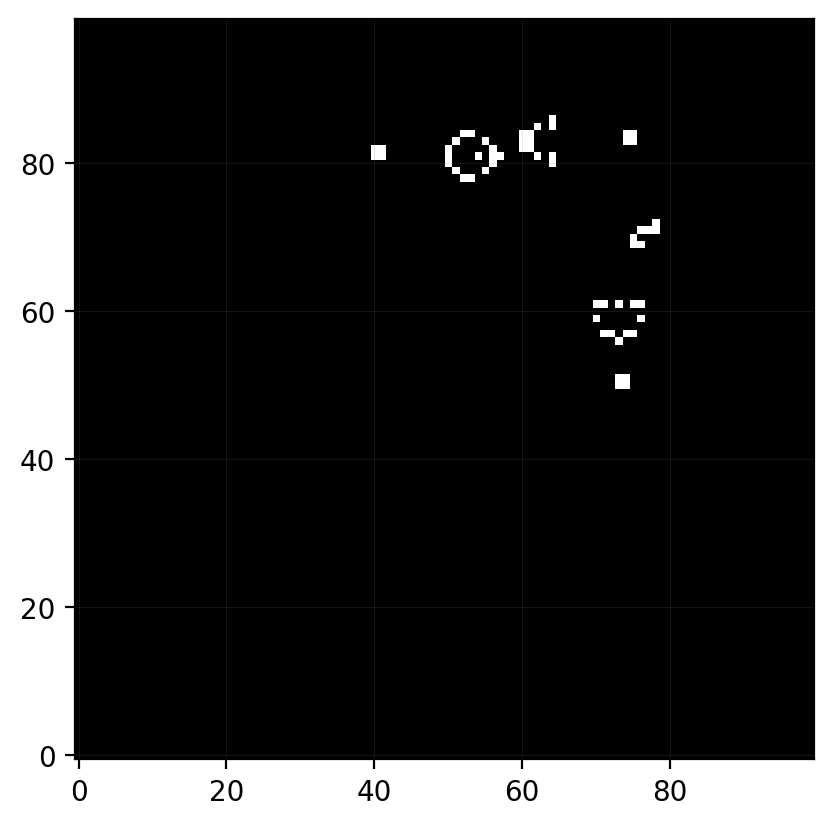

Animation: /home/ardo/mlem/Study/Sem8/MCS/M1/tests/output/notebook/reflector_gun_motion_1771473021569.mp4 (350101 bytes)


In [2]:
demo.run_reflector_gun_demo(ctx)


### B. Boolean Logic

We represent boolean logic in computation by `Logic Gates`. The basic logic gates are `NOT`, `AND` and `OR`.
From these three basic gates all combination of boolean operation and different kinds of gates can be made.

##### NOT Gate
This is the most simplest one, we have an input stream, and the gate consists of another `gun` that cancels out the input stream

##### AND Gate
This conists of two inputs, we can employ a similar implementation to NOT gate here and if only both inputs are on we get an output

##### OR Gate
Here we use the AND gate but add another `gun` and an `eater` right at the end of the second input. Thus when no input is present the second `gun` inside the component is blocked and if even one input is present the second `gun` gives out an output



*All the combinations of inputs can be found in the output directory as video files for review

not_gate_demo orientation=0
  A: kind=input, pos=(0,0), dir=315
  Y: kind=output, pos=(160,-160), dir=315
Snapshot: /home/ardo/mlem/Study/Sem8/MCS/M1/tests/output/notebook/not_gate_demo_setup_1771473971881.png (52016 bytes)


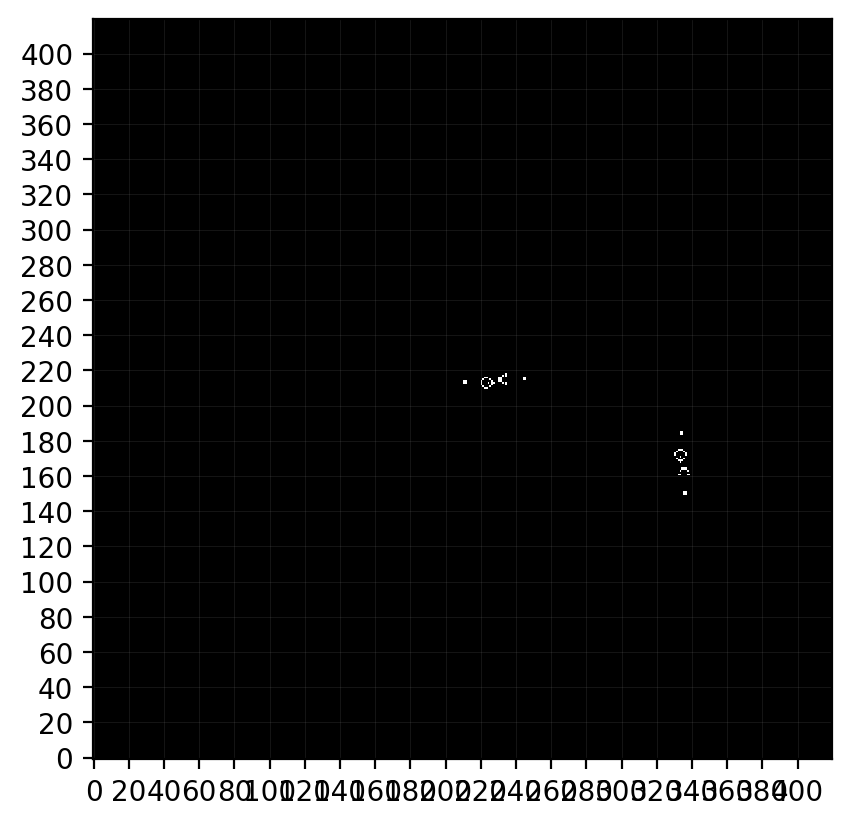

Animation: /home/ardo/mlem/Study/Sem8/MCS/M1/tests/output/notebook/not_gate_demo_motion_1771473972077.mp4 (300411 bytes)


and_gate_demo orientation=0
  A: kind=input, pos=(-60,60), dir=315
  B: kind=input, pos=(-120,60), dir=315
  Y: kind=output, pos=(36,45), dir=315
Snapshot: /home/ardo/mlem/Study/Sem8/MCS/M1/tests/output/notebook/and_gate_demo_setup_1771474010472.png (52115 bytes)


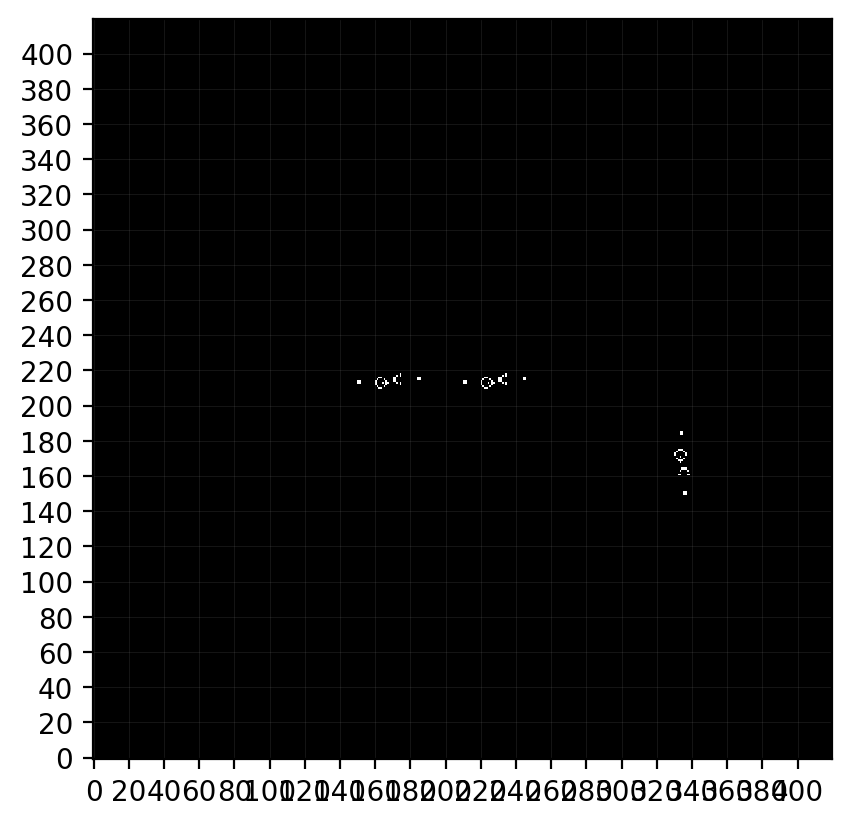

Animation: /home/ardo/mlem/Study/Sem8/MCS/M1/tests/output/notebook/and_gate_demo_motion_1771474010661.mp4 (415489 bytes)


or_gate_demo orientation=0
  A: kind=input, pos=(0,0), dir=315
  B: kind=input, pos=(-60,0), dir=315
  Y: kind=output, pos=(36,45), dir=315
Snapshot: /home/ardo/mlem/Study/Sem8/MCS/M1/tests/output/notebook/or_gate_demo_setup_1771474049603.png (52266 bytes)


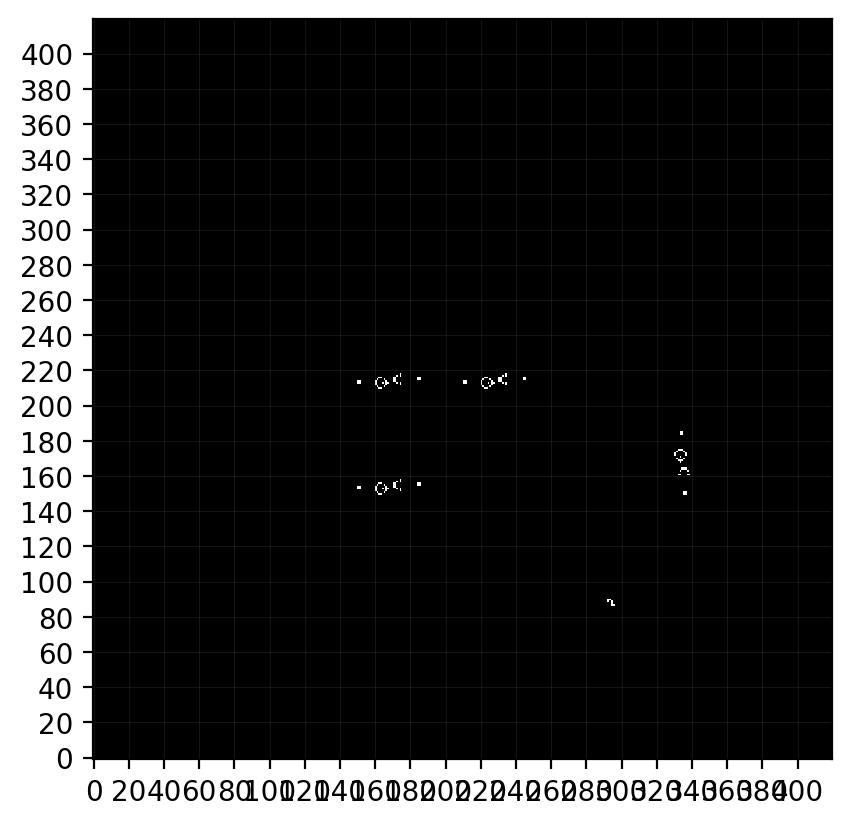

Animation: /home/ardo/mlem/Study/Sem8/MCS/M1/tests/output/notebook/or_gate_demo_motion_1771474049803.mp4 (527670 bytes)


In [2]:
demo.run_all_gate_demos(ctx)


Thus now we satisfy the second condiiton!!

### C. Memory

We can use a simple SR-Latch here to satisfy the requirement.

Due to time constraints i wasnt able to implement the memory latch so heres a reference from one of the guides i was following:

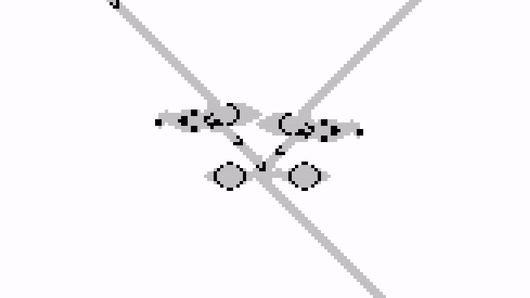

---


***With this we prove that CGoL is Turing Complete!!!***

## 4. Conclusion
The Repository represents a from scratch pipeline for proving life as turing complete while also building a starter pipeline to build a turing machine later on. In the current state the repository is just implemnented as a proof of concept though i tried making it as practical as possible.

In future I would like to expand the implementation of the pipeline and working on building some circuits using CGoL

#### References:
Main Motivation and Reference: 
- https://www.alanzucconi.com/2020/10/13/conways-game-of-life/
- https://bespoyasov.me/blog/binary-adder-in-the-game-of-life-2/
- https://github.com/bespoyasov/binary-full-adder-in-the-game-of-life

Source for RLEs: 
- https://conwaylife.com/wiki/Main_Page
- https://golly.sourceforge.io/
- https://copy.sh/life/?pattern=snark

---

All the eye-candy are stored in tests/output folder, feel free to look around!

peace <3